In [11]:

%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objs as go
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from scipy.stats import shapiro
from scipy.stats import sem, t


In [12]:
file_path = 'muon_simulation_results.csv'
df = pd.read_csv(file_path)
df[['x', 'y', 'z']] = df['Position'].str.strip('[]').str.split(expand=True).astype(float)
threshold = 1
df['Is_Cavity'] = (df['Energy_Loss'] < threshold) & (df['Energy_Loss'] != 0)
df= df[df['Energy_Loss'] != 0]
df.head()

,Muon_ID,Position,Direction,Energy,Energy_Loss,Is_Absorbed,x,y,z,Is_Cavity
1,0,[157.75195142 203.93749687 31.43731061],[-0.39390541 -0.84616522 0.35894701],604.747462,2.593000,False,157.751951,203.937497,31.437311,False
2,0,[157.71256088 203.85288034 31.47320531],[-0.43084303 -0.84417936 0.31896002],601.880612,2.866850,False,157.712561,203.852880,31.473205,False
3,0,[157.66947658 203.76846241 31.50510131],[-0.41077938 -0.86389257 0.29146169],599.004357,2.876255,False,157.669477,203.768462,31.505101,False
4,0,[157.62839864 203.68207315 31.53424748],[-0.44788913 -0.83151933 0.32858931],595.834652,3.169705,False,157.628399,203.682073,31.534247,False
5,0,[157.58360973 203.59892122 31.56710641],[-0.47346401 -0.82867732 0.29853934],592.975050,2.859602,False,157.583610,203.598921,31.567106,False


In [13]:
energy_loss_stats = df['Energy_Loss'].describe()
print(energy_loss_stats)

count    218599.000000
mean          3.387053
std           0.869905
min           0.000012
25%           2.972947
50%           3.476681
75%           3.983219
max           4.685977
Name: Energy_Loss, dtype: float64


Text(0.5, 0, 'Energy Loss')

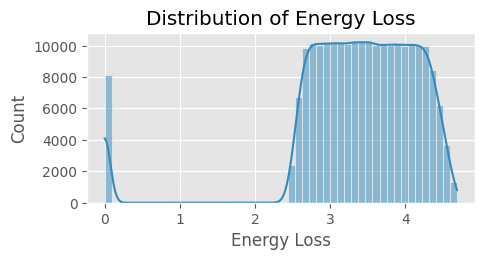

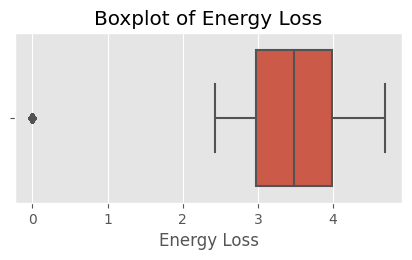

In [14]:
plt.style.use('ggplot')

dpi = 100  
size = 5  


plt.figure(figsize=(size, size*0.45), dpi=dpi)
sns.histplot(df['Energy_Loss'], bins=50, kde=True)
plt.xlabel('Energy Loss')
plt.ylabel('Count')
plt.title('Distribution of Energy Loss')
#plt.savefig('histogram.png', dpi=dpi)
#plt.close()  


plt.figure(figsize=(size, size*0.45), dpi=dpi)
sns.boxplot(x=df['Energy_Loss'])
plt.title('Boxplot of Energy Loss')
plt.xlabel('Energy Loss')
#plt.savefig('boxplot.png', dpi=dpi)  
#plt.close() 




In [15]:
shapiro_test = shapiro(df['Energy_Loss'].sample(800)) 
print(f"Shapiro-Wilk test:\nStatistics={shapiro_test[0]},p-value={shapiro_test[1]}")
skewness = df['Energy_Loss'].skew()
kurtosis = df['Energy_Loss'].kurt()
print(f"Skewness: {skewness}")
print(f"Kurtosis: {kurtosis}")
correlation_matrix = df.drop(['Energy_Loss', 'Muon_ID', 'Is_Absorbed'], axis=1).corrwith(df['Energy_Loss'])
print("\nCorrelation with Energy Loss:\n", correlation_matrix) 
confidence = 0.95
data = df['Energy_Loss']
n = len(data)
mean = np.mean(data)
std_err = sem(data)
h = std_err * t.ppf((1 + confidence) / 2, n - 1)
confidence_interval = (mean - h, mean + h)
print(f"95% confidence interval for the mean of Energy Loss:{confidence_interval}")

Shapiro-Wilk test:
Statistics=0.8162116408348083,p-value=3.0802444824992324e-29
Skewness: -1.9993308216584464
Kurtosis: 5.948566955037791

Correlation with Energy Loss:
 Energy       0.098950
x            0.004754
y            0.001427
z           -0.179825
Is_Cavity   -0.765620
dtype: float64
95% confidence interval for the mean of Energy Loss:(3.3834066089285844, 3.3906999794306167)


/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:88: UserWarning:

The figure layout has changed to tight



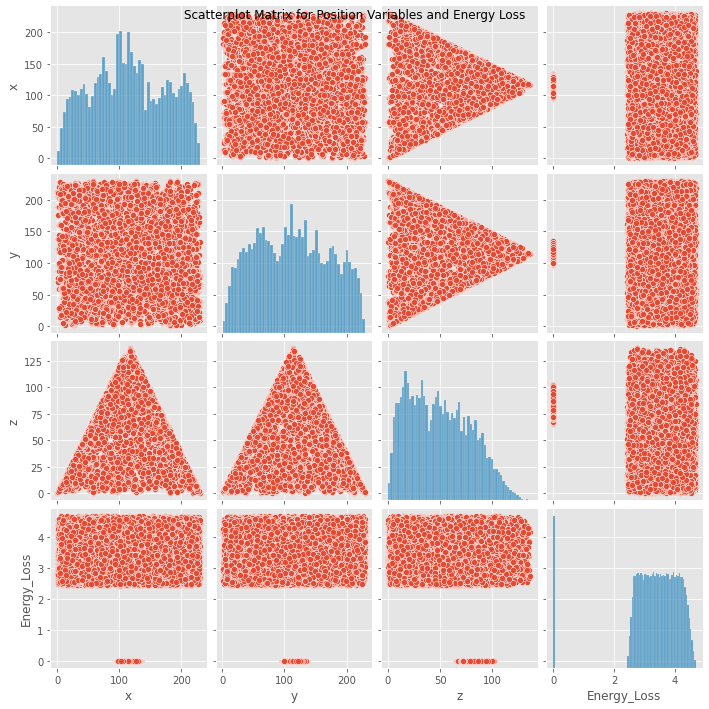

95% confidence interval for the mean of Energy Loss: (3.3834066089285844, 3.3906999794306167)


In [16]:
sns.pairplot(df.sample(80000), vars=['x', 'y', 'z', 'Energy_Loss'])
plt.suptitle('Scatterplot Matrix for Position Variables and Energy Loss')
plt.show()

confidence = 0.95
data = df['Energy_Loss']

n = len(data)
mean = np.mean(data)
std_err = sem(data)
h = std_err * t.ppf((1 + confidence) / 2, n - 1)

confidence_interval = (mean - h, mean + h)
print(f"95% confidence interval for the mean of Energy Loss: {confidence_interval}")

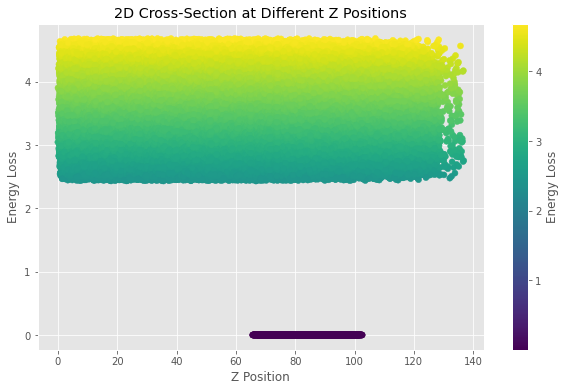

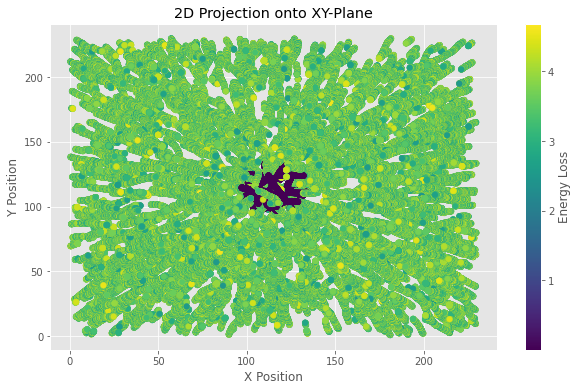

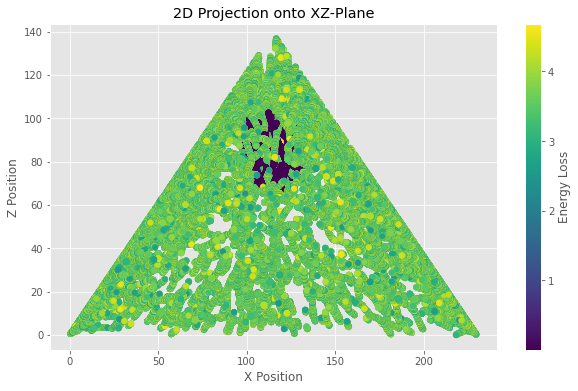

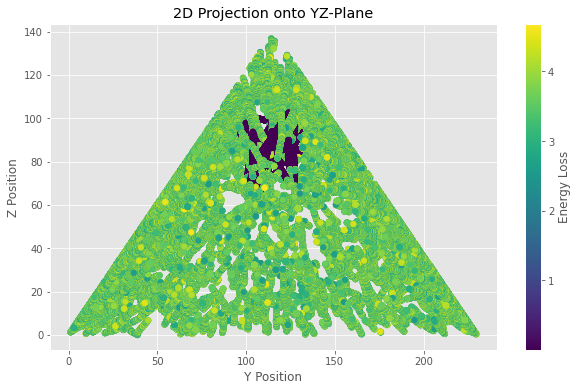

In [17]:
plt.figure(figsize=(10, 6))
plt.scatter(df['z'], df['Energy_Loss'], c=df['Energy_Loss'], cmap='viridis')
plt.colorbar(label='Energy Loss')
plt.xlabel('Z Position')
plt.ylabel('Energy Loss')
plt.title('2D Cross-Section at Different Z Positions')
plt.grid(True)
plt.show()
plt.figure(figsize=(10, 6))
plt.scatter(df['x'], df['y'], c=df['Energy_Loss'], cmap='viridis')
plt.colorbar(label='Energy Loss')
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.title('2D Projection onto XY-Plane')
plt.grid(True)
plt.show()
plt.figure(figsize=(10, 6))
plt.scatter(df['x'], df['z'], c=df['Energy_Loss'], cmap='viridis')
plt.colorbar(label='Energy Loss')
plt.xlabel('X Position')
plt.ylabel('Z Position')
plt.title('2D Projection onto XZ-Plane')
plt.grid(True)
plt.show() 
plt.figure(figsize=(10, 6))
plt.scatter(df['y'], df['z'], c=df['Energy_Loss'], cmap='viridis')
plt.colorbar(label='Energy Loss')
plt.xlabel('Y Position')
plt.ylabel('Z Position')
plt.title('2D Projection onto YZ-Plane')
plt.grid(True) 
plt.show()

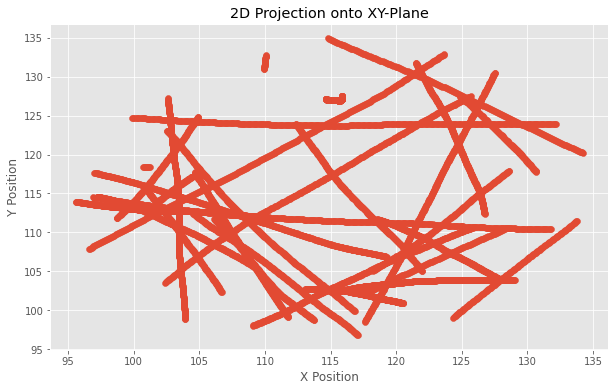

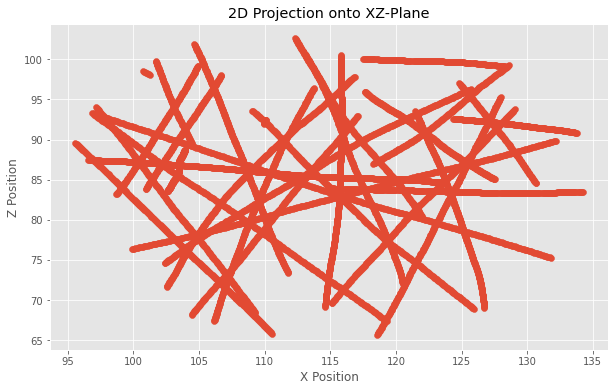

In [18]:
plt.figure(figsize=(10, 6))
pos = df[df['Is_Cavity'] == True]
plt.scatter(pos['x'], pos['y'])
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.title('2D Projection onto XY-Plane')
plt.grid(True)
plt.show()
plt.figure(figsize=(10, 6))
plt.scatter(pos['x'], pos['z'])
plt.xlabel('X Position')
plt.ylabel('Z Position')
plt.title('2D Projection onto XZ-Plane')
plt.grid(True)
plt.show()


In [19]:
# do not run this cell
trace = go.Scatter3d(
    x=df['x'],
    y=df['y'],
    z=df['z'],
    mode='markers',
    marker=dict(
        size=5,
        color=df['Energy_Loss'],  
        colorscale='Viridis',  
        opacity=0.8
    )
)
layout = go.Layout(
    margin=dict(l=0, r=0, b=0, t=0)
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()